# Data Cleaning, EDA, and NGrams - Alcoholics Anonymous
___
The idea here is to load in the created Alcoholics Anonymous CSV file and clean it up so the data will have no errors, null values, or empty values that may skew the result.  We will also be doing a bit of preprocessing and data exploring and analysis to assist on how to filter the columns down to the point where we believe it will benefit us on solving our problem that we are exploring.
___

## Import Libraries
___

In [258]:
#import libraries
import pandas as pd
import nltk 
import numpy as np
import sklearn as sk
import matplotlib.pyplot as plt
import seaborn as sns
import re
import string

pd.set_option('display.max_colwidth', 100)

stopwords = nltk.corpus.stopwords.words('english')
ps = nltk.PorterStemmer()
wn = nltk.WordNetLemmatizer()

# Enables Pandas to display all the columns
pd.set_option('display.max_columns', None)

# Enables Pandas to display all the rows
pd.set_option('display.max_rows', None)

%matplotlib inline

#subriddet name
subriddet_name = 'alcoholicsanonymous'

# Pull in CSV file

In [259]:
#create instance for read csv file
messages = pd.read_csv('../data/Raw_Alcohol_Anonymous.csv')

# Discover the Data

In [260]:
#display sample size of the whole dataframe
messages.head()

,Unnamed: 0,index,all_awardings,allow_live_comments,author,author_flair_css_class,author_flair_richtext,author_flair_text,author_flair_type,author_fullname,author_is_blocked,author_patreon_flair,author_premium,awarders,can_mod_post,contest_mode,created_utc,domain,full_link,gildings,id,is_created_from_ads_ui,is_crosspostable,is_meta,is_original_content,is_reddit_media_domain,is_robot_indexable,is_self,is_video,link_flair_background_color,link_flair_richtext,link_flair_text_color,link_flair_type,locked,media_only,no_follow,num_comments,num_crossposts,over_18,parent_whitelist_status,permalink,pinned,pwls,retrieved_on,score,selftext,send_replies,spoiler,stickied,subreddit,subreddit_id,subreddit_subscribers,subreddit_type,thumbnail,title,total_awards_received,treatment_tags,upvote_ratio,url,whitelist_status,wls,removed_by_category,post_hint,preview,edited,author_flair_background_color,author_flair_text_color,crosspost_parent,crosspost_parent_list,url_overridden_by_dest,author_cakeday,banned_by
0,0,0,[],False,Brilliant-You2827,NaN,[],NaN,text,t2_fy1dtqwb,False,False,False,[],False,False,1636008022,self.alcoholicsanonymous,https://www.reddit.com/r/alcoholicsanonymous/comments/qmepd1/i_sang_sober/,{},qmepd1,False,True,False,False,False,True,True,False,NaN,[],dark,text,False,False,True,0,0,False,no_ads,/r/alcoholicsanonymous/comments/qmepd1/i_sang_sober/,False,0.0,1636008033,1,"I used to sing in a band. I also have sung a lot of karaoke. I have always been a singer. I am good at it. Once I got sober though, I just stopped. It's been almost 2 years since I have sang karaoke even. Partly because of Covid but mostly because I couldn't bring myself to go into a bar and sing sober. \nWell I finally went tonight. Me and my step dad went and drank Pepsi and I sang one song. I was terrified. Shaking before I even started. I mean almost a panic attack if I would have let my emotions take over. But I love to sing I was determined. I put up my song and had to wait for like 7 people to go before me. Every time he called the next singer my heart was beating so fast and I was short of breath. It was ridiculous. I mean, I have been singing my entire life. Why was a so damn scared. Finally they call my name and I get up there. My step dad said after the first two lines of the song he was a little worried. But after that, I fucking killed it. I killed it! I was amazing. I did it, and I did it fucking sober! I can still sing and I can still sing Rock and I can still get into it. Sober!! \nAfterwards I literally grabbed my purse and I walked out. I was shaking so bad I had to move. Everyone cheered and clapped and they wanted me to sing again but one was enough. I will probably go again soon with someone from the program that sings but damn. That first song sober. It was crazy. My nerves were insane and just one shot of vodka would have calmed me right down. But I don't need that anymore. Because of AA I know that if something terrifies me, I can do it anyway. I got a HP that is more powerful than what booze could ever give me. Thank you AA!",True,False,False,alcoholicsanonymous,t5_2s3xd,39175,public,self,I sang sober!!,0,[],1.0,https://www.reddit.com/r/alcoholicsanonymous/comments/qmepd1/i_sang_sober/,no_ads,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,1,1,[],False,adustyoldcrow462,NaN,[],NaN,text,t2_1cgwbvg2,False,False,False,[],False,False,1636006988,self.alcoholicsanonymous,https://www.reddit.com/r/alcoholicsanonymous/comments/qmegz3/mildly_concerned/,{},qmegz3,False,True,False,False,False,True,True,False,NaN,[],dark,text,False,False,True,0,0,False,no_ads,/r/alcoholicsanonymous/comments/qmegz3/mildly_concerned/,False,0.0,1636006999,1,I’ve cut down on drinking and doubled my dose of Wellbutrin (maintaining the same amount of Lamictal) and tonight I’m feeling overheated and inexplicably terrified. My heart is pounding. I’m a bit twitchy. I am so afraid of the prospect of a seizure. Please grant me reassurance,True,False,False,alcoholicsanonymous,t

Because the website Reddit provides an extensive breakdown of each category, majority of them does not fit our critera as useful information.  

In [261]:
#check the description
messages.describe()

,Unnamed: 0,index,author_flair_css_class,author_flair_text,created_utc,link_flair_background_color,num_comments,num_crossposts,pwls,retrieved_on,score,subreddit_subscribers,total_awards_received,upvote_ratio,wls,edited,author_flair_background_color
count,2000.000000,2000.000000,0.0,0.0,2.000000e+03,0.0,2000.000000,2000.0,1986.0,2.000000e+03,2000.000000,2000.000000,2000.000000,2000.000000,1986.0,1.000000e+01,0.0
mean,999.500000,49.500000,NaN,NaN,1.632619e+09,NaN,13.185000,0.0,0.0,1.632620e+09,1.300000,37941.530500,0.005000,0.995175,0.0,1.633511e+09,NaN
std,577.494589,28.873289,NaN,NaN,1.958560e+06,NaN,17.854696,0.0,0.0,1.958169e+06,1.931027,712.310015,0.077317,0.043798,0.0,2.475713e+06,NaN
min,0.000000,0.000000,NaN,NaN,1.629169e+09,NaN,0.000000,0.0,0.0,1.629169e+09,0.000000,36692.000000,0.000000,0.130000,0.0,1.629463e+09,NaN
25%,499.750000,24.750000,NaN,NaN,1.630971e+09,NaN,3.000000,0.0,0.0,1.630971e+09,1.000000,37312.000000,0.000000,1.000000,0.0,1.632636e+09,NaN
50%,999.500000,49.500000,NaN,NaN,1.632668e+09,NaN,8.000000,0.0,0.0,1.632668e+09,1.000000,37931.500000,0.000000,1.000000,0.0,1.633545e+09,NaN
75%,1499.250000,74.250000,NaN,NaN,1.634300e+09,NaN,17.000000,0.0,0.0,1.634300e+09,1.000000,38570.250000,0.000000,1.000000,0.0,1.635807e+09,NaN
max,1999.000000,99.000000,NaN,NaN,1.636008e+09,NaN,261.000000,0.0,0.0,1.636008e+09,28.000000,39176.000000,2.000000,1.000000,0.0,1.635831e+09,NaN


In [262]:
#display info
messages.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2000 entries, 0 to 1999
Data columns (total 72 columns):
 #   Column                         Non-Null Count  Dtype  
---  ------                         --------------  -----  
 0   Unnamed: 0                     2000 non-null   int64  
 1   index                          2000 non-null   int64  
 2   all_awardings                  2000 non-null   object 
 3   allow_live_comments            2000 non-null   bool   
 4   author                         2000 non-null   object 
 5   author_flair_css_class         0 non-null      float64
 6   author_flair_richtext          1990 non-null   object 
 7   author_flair_text              0 non-null      float64
 8   author_flair_type              1990 non-null   object 
 9   author_fullname                1990 non-null   object 
 10  author_is_blocked              2000 non-null   bool   
 11  author_patreon_flair           1990 non-null   object 
 12  author_premium                 1990 non-null   o

Since the project's problem statement is related to determining which subreddit the author's post should belong to, we'll be filtering down the large set of predetermined columns to the ones we believe will provide us with the best results for our study.

## Filter Columns to Fit Study's Need
___

In [263]:
#filter out the one that will be useful for study
filtered_messages = messages.filter(['author', 'title', 'selftext', 'subreddit'])

In [264]:
#see sample of filtered dataframe
filtered_messages.head()

,author,title,selftext,subreddit
0,Brilliant-You2827,I sang sober!!,"I used to sing in a band. I also have sung a lot of karaoke. I have always been a singer. I am good at it. Once I got sober though, I just stopped. It's been almost 2 years since I have sang karaoke even. Partly because of Covid but mostly because I couldn't bring myself to go into a bar and sing sober. \nWell I finally went tonight. Me and my step dad went and drank Pepsi and I sang one song. I was terrified. Shaking before I even started. I mean almost a panic attack if I would have let my emotions take over. But I love to sing I was determined. I put up my song and had to wait for like 7 people to go before me. Every time he called the next singer my heart was beating so fast and I was short of breath. It was ridiculous. I mean, I have been singing my entire life. Why was a so damn scared. Finally they call my name and I get up there. My step dad said after the first two lines of the song he was a little worried. But after that, I fucking killed it. I killed it! I was amazing. I did it, and I did it fucking sober! I can still sing and I can still sing Rock and I can still get into it. Sober!! \nAfterwards I literally grabbed my purse and I walked out. I was shaking so bad I had to move. Everyone cheered and clapped and they wanted me to sing again but one was enough. I will probably go again soon with someone from the program that sings but damn. That first song sober. It was crazy. My nerves were insane and just one shot of vodka would have calmed me right down. But I don't need that anymore. Because of AA I know that if something terrifies me, I can do it anyway. I got a HP that is more powerful than what booze could ever give me. Thank you AA!",alcoholicsanonymous
1,adustyoldcrow462,Mildly concerned,I’ve cut down on drinking and doubled my dose of Wellbutrin (maintaining the same amount of Lamictal) and tonight I’m feeling overheated and inexplicably terrified. My heart is pounding. I’m a bit twitchy. I am so afraid of the prospect of a seizure. Please grant me reassurance,alcoholicsanonymous
2,MixFinancial9704,Surrendering to the winning side!,"In the meeting tonight this was the topic. It struck me because we fight so hard to hold on to the habits and lifestyles that completely demoralize are true authentic self . I was thinking back and wondering why so long did I hold on to the pain, was it pride or ego maybe it was the fact that I didn’t believe that life could get better. I had to do something and frankly even the bottle was getting old or should I say the same embarrassing messes I kept re-enacting hoping that one day my life would change. I person I once partied with was sober and suggested a meeting so I went. I walked into that room of 80+ alcoholics and was uncomfortable and not really taking it serious. I learned that day that I might have a slim chance of getting 1 month sober , it’s funny 1 month was my goal that was back in June 1 2018 3 + years later I was my home group and this was the topic . I did not know back then but I surrendered my old life for a brand new one and I don’t regret which team I have chosen. \n\nBest decision ever",alcoholicsanonymous
3,PsychologyLoose2787,I dont know what to do,[removed],alcoholicsanonymous
4,CAMPERzNITEMARE,Just Wanted to share my favourite song that got through the worst times in my life,https://m.youtube.com/watch?v=p4cJv6s_Yjw,alcoholicsanonymous


### Determine if there are any relationship between number of post to the authors

In [265]:
#see who is contributing the most
filtered_messages['author'].value_counts()

Whtsox                  80
SnooDogs8125            22
AnonymousInColorado     14
EclecticFrontier        14
haygoodie9              11
RadicalizedSummer91     10
OneRing2RuleEmAll       10
[deleted]               10
Lizzthelezz              9
Poptotnot                9
PortCityBlitz            8
Necessary_Signal7295     7
NothingWorksLikeWork     7
Myredditname423          7
DoobiesDoodleDen         7
selfloathinginlv         7
No_Discussion_           7
madieish                 7
santaanawinds2017        6
Environmental_Thing5     6
omhaverly                6
HappierMaple             6
hellzoom1                6
PsychAdvisor             5
clarencemuraco           5
Manoww1995               5
Sunniedelight92          5
Guilty_Hair_3059         5
papersucculent6          5
Open_Wind5362            5
Alternative_Agent_56     5
Grotto2018               4
mat2153894               4
eucalyptuselephant       4
cleanhouz                4
xxxwangfirexxx           4
ViciousAlien             4
J

The author, "**Whtsox**" seems to be the top contributor for the Alcoholics Anonymous subreddit.   After futher study, we found out that this author is the moderator of the subreddit.

### Data Cleaning: Determine the number of null values in the filtered messages dataframe

In [266]:
#display filtered infomation to see if the types, number of non-null count and filtered columns checks out
filtered_messages.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2000 entries, 0 to 1999
Data columns (total 4 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   author     2000 non-null   object
 1   title      2000 non-null   object
 2   selftext   1897 non-null   object
 3   subreddit  2000 non-null   object
dtypes: object(4)
memory usage: 62.6+ KB


In [267]:
#number of nulled files in selftext column
print("There are " + str(filtered_messages['selftext'].isnull().sum()) + " of Null values.")

There are 103 of Null values.


### Data Cleaning: Determine the number of null values should be dropped or find alternatives

In [268]:
#read a sample amount of nulled selftext to see if we can drop them
filtered_messages[filtered_messages['selftext'].isnull()].head()

,author,title,selftext,subreddit
64,lhscf1,"I don’t know if this will help but I desperately want to get sober. Is there a (reliable) site I can find local and up to date AA meetings on? Or if anyone has tried it, does online AA work?",NaN,alcoholicsanonymous
65,19Gypsy_soul87,Well my mother told me I wasn't invited to Christmas because all I do is break her heart. Apparently telling her she's an alcoholic and that I don't want to be around her when she's drinking because I've been sober for three years and seven months is breaking her heart.,NaN,alcoholicsanonymous
93,boyo85,Favorite movies and books about recovery from alcohol; go!,NaN,alcoholicsanonymous
101,RogerRabbit1234,16 months sober and just tried OJ for the first time and no craving for vodka. What a great feeling.,NaN,alcoholicsanonymous
134,sami1147,Should I go to rehab if everyone thinks I should even if I think I can do it without it this time?,NaN,alcoholicsanonymous


___
Although the selftext column does contain null values, some title column within the sample does have enough information that can be used for the study. Therefore, we will replace the null values as 'None' as this is a personal comment from the author so we cannot be the judge and provide a filler answer to the empty space.
___

In [269]:
#convert the null value to None value because it has the biggest percentage 
filtered_messages['selftext'] = filtered_messages['selftext'].replace(np.nan, 'None')

In [270]:
#see if there are anymore null values in selftext column
print("There are " + str(filtered_messages['selftext'].isnull().sum()) + " of Null values.")

There are 0 of Null values.


In [271]:
#create a decending order to see who posted the most and if there is a change in position
num_authors = filtered_messages.groupby('author')['selftext'].count().sort_values(ascending=False)
num_authors.head(10)

author
Whtsox                 80
SnooDogs8125           22
AnonymousInColorado    14
EclecticFrontier       14
haygoodie9             11
RadicalizedSummer91    10
OneRing2RuleEmAll      10
[deleted]              10
Poptotnot               9
Lizzthelezz             9
Name: selftext, dtype: int64

### Data Cleaning: Find the duplicates and drop them

In [272]:
#find out if there are any duplicate posts under selftext columns
filtered_messages.duplicated().sum()

3

In [273]:
#find out where are the duplicates
filtered_messages[filtered_messages.duplicated()]

,author,title,selftext,subreddit
577,Aromatic_Tonight_868,sponsie keeps relapsing,None,alcoholicsanonymous
1540,CryptographerFull933,13 days sober,[removed],alcoholicsanonymous
1721,bobby2bundles,Running away the easy way !,"\nIn the face of your own conflicts, so not try to drink or dope, trying to escape from your own mind, because from every undue absence you will return to the damage or needs that you have created in the intimate world, in order to heal them. It is very common that in the face of emotional pressures we feel as a result of the problems that disturb our peace, we seek relief from alcohol and drugs. This escape is capable of generating greater damage in our journey, which we will be forced to heal, under the weight of greater suffering. It is necessary to think about the cost-benefit ratio. The apparent benefits that alcohol and drugs offer, anesthetized our Dad and distressed mind for a few minutes, so not compensate for the serious physical and spiritual harm that will be.generated. We will always return with a greater amount of disturbance after the chemical effects of the drink and narcotics cease. Furthermore, very often the drugged or drink person does things that, in good conscience, he\she would never do, bitterly regretting their lack of common sense, and sometimes for the rest of his\her life. We will be better off seeking relief from reliable sources. Prayer calms the heart, calms the mind, produces physical benefits, as it relaxes tensions, and still allows us divine inspiration to overcome our pains. Reading high spiritual works opens the window of the mind and supplies the spirit with renewing ideas, changing the psyche for the better. The work of helping others link is to the divine currents of love, from where we will extract the necessary energies to assess our difficulties. We will find peace in prayer, in the meditation of divine truths and in the work of love for the others. If we do all of this, we will be taken by the master to the sky of serenity, and we will no longer need to sink into the Hell of drugs or alcohol.",alcoholicsanonymous


In [274]:
#Because there is only 4 duplicates within the whole filtered data set, it safe to drop it without compromising the result
filtered_messages.drop_duplicates(inplace=True)

In [275]:
#check if there are anymore duplicates
filtered_messages.duplicated().sum()

0

In [276]:
#confirm that the number of non-null counts are the same through all the columns
filtered_messages.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1997 entries, 0 to 1999
Data columns (total 4 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   author     1997 non-null   object
 1   title      1997 non-null   object
 2   selftext   1997 non-null   object
 3   subreddit  1997 non-null   object
dtypes: object(4)
memory usage: 78.0+ KB


In [277]:
#create a new dataset to prevent any errors
filtered_messages_df = filtered_messages
mod_filtered_messages_df = filtered_messages_df[['selftext', 'subreddit']]
#mod_filtered_messages_df.head()
mod_filtered_messages_df.to_csv('../data/Clean_Data_AA_Filtered_Messages_DF.csv', index=None)

# Clean Title Column
___

## Remove Punctuations

In [278]:
# string.punctuation comprises of a list of all punctuations
import string
string.punctuation

'!"#$%&\'()*+,-./:;<=>?@[\\]^_`{|}~'

In [279]:
#create a funtion to remove all punctuation
def remove_punct(text):
    # store character only if it is not a punctuation
    text_nopunct = "".join([char for char in text if char not in string.punctuation])
    return text_nopunct
#create a new column named 'title_clean' to hold the new set of strings
filtered_messages_df['title_clean'] = filtered_messages_df['title'].apply(lambda x: remove_punct(x))
#display a sample size of the new
filtered_messages_df.head()

,author,title,selftext,subreddit,title_clean
0,Brilliant-You2827,I sang sober!!,"I used to sing in a band. I also have sung a lot of karaoke. I have always been a singer. I am good at it. Once I got sober though, I just stopped. It's been almost 2 years since I have sang karaoke even. Partly because of Covid but mostly because I couldn't bring myself to go into a bar and sing sober. \nWell I finally went tonight. Me and my step dad went and drank Pepsi and I sang one song. I was terrified. Shaking before I even started. I mean almost a panic attack if I would have let my emotions take over. But I love to sing I was determined. I put up my song and had to wait for like 7 people to go before me. Every time he called the next singer my heart was beating so fast and I was short of breath. It was ridiculous. I mean, I have been singing my entire life. Why was a so damn scared. Finally they call my name and I get up there. My step dad said after the first two lines of the song he was a little worried. But after that, I fucking killed it. I killed it! I was amazing. I did it, and I did it fucking sober! I can still sing and I can still sing Rock and I can still get into it. Sober!! \nAfterwards I literally grabbed my purse and I walked out. I was shaking so bad I had to move. Everyone cheered and clapped and they wanted me to sing again but one was enough. I will probably go again soon with someone from the program that sings but damn. That first song sober. It was crazy. My nerves were insane and just one shot of vodka would have calmed me right down. But I don't need that anymore. Because of AA I know that if something terrifies me, I can do it anyway. I got a HP that is more powerful than what booze could ever give me. Thank you AA!",alcoholicsanonymous,I sang sober
1,adustyoldcrow462,Mildly concerned,I’ve cut down on drinking and doubled my dose of Wellbutrin (maintaining the same amount of Lamictal) and tonight I’m feeling overheated and inexplicably terrified. My heart is pounding. I’m a bit twitchy. I am so afraid of the prospect of a seizure. Please grant me reassurance,alcoholicsanonymous,Mildly concerned
2,MixFinancial9704,Surrendering to the winning side!,"In the meeting tonight this was the topic. It struck me because we fight so hard to hold on to the habits and lifestyles that completely demoralize are true authentic self . I was thinking back and wondering why so long did I hold on to the pain, was it pride or ego maybe it was the fact that I didn’t believe that life could get better. I had to do something and frankly even the bottle was getting old or should I say the same embarrassing messes I kept re-enacting hoping that one day my life would change. I person I once partied with was sober and suggested a meeting so I went. I walked into that room of 80+ alcoholics and was uncomfortable and not really taking it serious. I learned that day that I might have a slim chance of getting 1 month sober , it’s funny 1 month was my goal that was back in June 1 2018 3 + years later I was my home group and this was the topic . I did not know back then but I surrendered my old life for a brand new one and I don’t regret which team I have chosen. \n\nBest decision ever",alcoholicsanonymous,Surrendering to the winning side
3,PsychologyLoose2787,I dont know what to do,[removed],alcoholicsanonymous,I dont know what to do
4,CAMPERzNITEMARE,Just Wanted to share my favourite song that got through the worst times in my life,https://m.youtube.com/watch?v=p4cJv6s_Yjw,alcoholicsanonymous,Just Wanted to share my favourite song that got through the worst times in my life


## Tokenization

In [280]:
import re

def tokenize(text):
    # \W matches any non-word character (equivalent to [^a-zA-Z0-9_]). This does not include spaces i.e. \s
    # Add a + just in case there are 2 or more spaces between certain words
    tokens = re.split('\W+', text)
    return tokens

filtered_messages_df['title_clean_tokenized'] = filtered_messages_df['title_clean'].apply(lambda x: tokenize(x.lower()))

filtered_messages_df.head()

,author,title,selftext,subreddit,title_clean,title_clean_tokenized
0,Brilliant-You2827,I sang sober!!,"I used to sing in a band. I also have sung a lot of karaoke. I have always been a singer. I am good at it. Once I got sober though, I just stopped. It's been almost 2 years since I have sang karaoke even. Partly because of Covid but mostly because I couldn't bring myself to go into a bar and sing sober. \nWell I finally went tonight. Me and my step dad went and drank Pepsi and I sang one song. I was terrified. Shaking before I even started. I mean almost a panic attack if I would have let my emotions take over. But I love to sing I was determined. I put up my song and had to wait for like 7 people to go before me. Every time he called the next singer my heart was beating so fast and I was short of breath. It was ridiculous. I mean, I have been singing my entire life. Why was a so damn scared. Finally they call my name and I get up there. My step dad said after the first two lines of the song he was a little worried. But after that, I fucking killed it. I killed it! I was amazing. I did it, and I did it fucking sober! I can still sing and I can still sing Rock and I can still get into it. Sober!! \nAfterwards I literally grabbed my purse and I walked out. I was shaking so bad I had to move. Everyone cheered and clapped and they wanted me to sing again but one was enough. I will probably go again soon with someone from the program that sings but damn. That first song sober. It was crazy. My nerves were insane and just one shot of vodka would have calmed me right down. But I don't need that anymore. Because of AA I know that if something terrifies me, I can do it anyway. I got a HP that is more powerful than what booze could ever give me. Thank you AA!",alcoholicsanonymous,I sang sober,"[i, sang, sober]"
1,adustyoldcrow462,Mildly concerned,I’ve cut down on drinking and doubled my dose of Wellbutrin (maintaining the same amount of Lamictal) and tonight I’m feeling overheated and inexplicably terrified. My heart is pounding. I’m a bit twitchy. I am so afraid of the prospect of a seizure. Please grant me reassurance,alcoholicsanonymous,Mildly concerned,"[mildly, concerned]"
2,MixFinancial9704,Surrendering to the winning side!,"In the meeting tonight this was the topic. It struck me because we fight so hard to hold on to the habits and lifestyles that completely demoralize are true authentic self . I was thinking back and wondering why so long did I hold on to the pain, was it pride or ego maybe it was the fact that I didn’t believe that life could get better. I had to do something and frankly even the bottle was getting old or should I say the same embarrassing messes I kept re-enacting hoping that one day my life would change. I person I once partied with was sober and suggested a meeting so I went. I walked into that room of 80+ alcoholics and was uncomfortable and not really taking it serious. I learned that day that I might have a slim chance of getting 1 month sober , it’s funny 1 month was my goal that was back in June 1 2018 3 + years later I was my home group and this was the topic . I did not know back then but I surrendered my old life for a brand new one and I don’t regret which team I have chosen. \n\nBest decision ever",alcoholicsanonymous,Surrendering to the winning side,"[surrendering, to, the, winning, side]"
3,PsychologyLoose2787,I dont know what to do,[removed],alcoholicsanonymous,I dont know what to do,"[i, dont, know, what, to, do]"
4,CAMPERzNITEMARE,Just Wanted to share my favourite song that got through the worst times in my life,https://m.youtube.com/watch?v=p4cJv6s_Yjw,alcoholicsanonymous,Just Wanted to share my favourite song that got through the worst times in my life,"[just, wanted, to, share, my, favourite, song, that, got, through, the, worst, times, in, my, life]"


## For Title: Remove stopwords

In [281]:
import nltk

#using English as the base for all the stopwords
stopword = nltk.corpus.stopwords.words('english')

#create a function that removes all the default stopwords
def remove_stopwords(tokenized_list):
    # Store in text only if word is not found in stopword
    text = [word for word in tokenized_list if word not in stopword]
    return text

#create a new column for cleaned set of words without any stopwords
filtered_messages_df['title_clean_nostopwords'] = filtered_messages_df['title_clean_tokenized'].apply(lambda x: remove_stopwords(x))

#display a sample size of the updated dataframe
filtered_messages_df.head()

,author,title,selftext,subreddit,title_clean,title_clean_tokenized,title_clean_nostopwords
0,Brilliant-You2827,I sang sober!!,"I used to sing in a band. I also have sung a lot of karaoke. I have always been a singer. I am good at it. Once I got sober though, I just stopped. It's been almost 2 years since I have sang karaoke even. Partly because of Covid but mostly because I couldn't bring myself to go into a bar and sing sober. \nWell I finally went tonight. Me and my step dad went and drank Pepsi and I sang one song. I was terrified. Shaking before I even started. I mean almost a panic attack if I would have let my emotions take over. But I love to sing I was determined. I put up my song and had to wait for like 7 people to go before me. Every time he called the next singer my heart was beating so fast and I was short of breath. It was ridiculous. I mean, I have been singing my entire life. Why was a so damn scared. Finally they call my name and I get up there. My step dad said after the first two lines of the song he was a little worried. But after that, I fucking killed it. I killed it! I was amazing. I did it, and I did it fucking sober! I can still sing and I can still sing Rock and I can still get into it. Sober!! \nAfterwards I literally grabbed my purse and I walked out. I was shaking so bad I had to move. Everyone cheered and clapped and they wanted me to sing again but one was enough. I will probably go again soon with someone from the program that sings but damn. That first song sober. It was crazy. My nerves were insane and just one shot of vodka would have calmed me right down. But I don't need that anymore. Because of AA I know that if something terrifies me, I can do it anyway. I got a HP that is more powerful than what booze could ever give me. Thank you AA!",alcoholicsanonymous,I sang sober,"[i, sang, sober]","[sang, sober]"
1,adustyoldcrow462,Mildly concerned,I’ve cut down on drinking and doubled my dose of Wellbutrin (maintaining the same amount of Lamictal) and tonight I’m feeling overheated and inexplicably terrified. My heart is pounding. I’m a bit twitchy. I am so afraid of the prospect of a seizure. Please grant me reassurance,alcoholicsanonymous,Mildly concerned,"[mildly, concerned]","[mildly, concerned]"
2,MixFinancial9704,Surrendering to the winning side!,"In the meeting tonight this was the topic. It struck me because we fight so hard to hold on to the habits and lifestyles that completely demoralize are true authentic self . I was thinking back and wondering why so long did I hold on to the pain, was it pride or ego maybe it was the fact that I didn’t believe that life could get better. I had to do something and frankly even the bottle was getting old or should I say the same embarrassing messes I kept re-enacting hoping that one day my life would change. I person I once partied with was sober and suggested a meeting so I went. I walked into that room of 80+ alcoholics and was uncomfortable and not really taking it serious. I learned that day that I might have a slim chance of getting 1 month sober , it’s funny 1 month was my goal that was back in June 1 2018 3 + years later I was my home group and this was the topic . I did not know back then but I surrendered my old life for a brand new one and I don’t regret which team I have chosen. \n\nBest decision ever",alcoholicsanonymous,Surrendering to the winning side,"[surrendering, to, the, winning, side]","[surrendering, winning, side]"
3,PsychologyLoose2787,I dont know what to do,[removed],alcoholicsanonymous,I dont know what to do,"[i, dont, know, what, to, do]","[dont, know]"
4,CAMPERzNITEMARE,Just Wanted to share my favourite song that got through the worst times in my life,https://m.youtube.com/watch?v=p4cJv6s_Yjw,alcoholicsanonymous,Just Wanted to share my favourite song that got through the worst times in my life,"[just, wanted, to, share, my, favourite, song, that, got, through, the, worst, times, in, my, life]","[wanted, share, favourite, son

# For Title: Lemmatize the text

In [282]:
#create an instance for lemmatizer function
wn = nltk.WordNetLemmatizer()

#create a function to lemmatizing the tokened words
def lemmatizing(tokenized_text):
    # return list of all lemmatized words for their corresponding words in tokenized_text
    text = [wn.lemmatize(word) for word in tokenized_text]
    return text

#add new column for the lammatizied words
filtered_messages_df['title_clean_lemmatized'] = filtered_messages_df['title_clean_nostopwords'].apply(lambda x: lemmatizing(x))

#display a sample of the updated dataframe
filtered_messages_df.head(10)

,author,title,selftext,subreddit,title_clean,title_clean_tokenized,title_clean_nostopwords,title_clean_lemmatized
0,Brilliant-You2827,I sang sober!!,"I used to sing in a band. I also have sung a lot of karaoke. I have always been a singer. I am good at it. Once I got sober though, I just stopped. It's been almost 2 years since I have sang karaoke even. Partly because of Covid but mostly because I couldn't bring myself to go into a bar and sing sober. \nWell I finally went tonight. Me and my step dad went and drank Pepsi and I sang one song. I was terrified. Shaking before I even started. I mean almost a panic attack if I would have let my emotions take over. But I love to sing I was determined. I put up my song and had to wait for like 7 people to go before me. Every time he called the next singer my heart was beating so fast and I was short of breath. It was ridiculous. I mean, I have been singing my entire life. Why was a so damn scared. Finally they call my name and I get up there. My step dad said after the first two lines of the song he was a little worried. But after that, I fucking killed it. I killed it! I was amazing. I did it, and I did it fucking sober! I can still sing and I can still sing Rock and I can still get into it. Sober!! \nAfterwards I literally grabbed my purse and I walked out. I was shaking so bad I had to move. Everyone cheered and clapped and they wanted me to sing again but one was enough. I will probably go again soon with someone from the program that sings but damn. That first song sober. It was crazy. My nerves were insane and just one shot of vodka would have calmed me right down. But I don't need that anymore. Because of AA I know that if something terrifies me, I can do it anyway. I got a HP that is more powerful than what booze could ever give me. Thank you AA!",alcoholicsanonymous,I sang sober,"[i, sang, sober]","[sang, sober]","[sang, sober]"
1,adustyoldcrow462,Mildly concerned,I’ve cut down on drinking and doubled my dose of Wellbutrin (maintaining the same amount of Lamictal) and tonight I’m feeling overheated and inexplicably terrified. My heart is pounding. I’m a bit twitchy. I am so afraid of the prospect of a seizure. Please grant me reassurance,alcoholicsanonymous,Mildly concerned,"[mildly, concerned]","[mildly, concerned]","[mildly, concerned]"
2,MixFinancial9704,Surrendering to the winning side!,"In the meeting tonight this was the topic. It struck me because we fight so hard to hold on to the habits and lifestyles that completely demoralize are true authentic self . I was thinking back and wondering why so long did I hold on to the pain, was it pride or ego maybe it was the fact that I didn’t believe that life could get better. I had to do something and frankly even the bottle was getting old or should I say the same embarrassing messes I kept re-enacting hoping that one day my life would change. I person I once partied with was sober and suggested a meeting so I went. I walked into that room of 80+ alcoholics and was uncomfortable and not really taking it serious. I learned that day that I might have a slim chance of getting 1 month sober , it’s funny 1 month was my goal that was back in June 1 2018 3 + years later I was my home group and this was the topic . I did not know back then but I surrendered my old life for a brand new one and I don’t regret which team I have chosen. \n\nBest decision ever",alcoholicsanonymous,Surrendering to the winning side,"[surrendering, to, the, winning, side]","[surrendering, winning, side]","[surrendering, winning, side]"
3,PsychologyLoose2787,I dont know what to do,[removed],alcoholicsanonymous,I dont know what to do,"[i, dont, know, what, to, do]","[dont, know]","[dont, know]"
4,CAMPERzNITEMARE,Just Wanted to share my favourite song that got through the worst times in my life,https://m.youtube.com/watch?v=p4cJv6s_Yjw,alcoholicsanonymous,Just Wanted to share my favourite song that got through the worst times in my life,"[just, wanted, to, share

### For Title: Apply CountVectorizer

In [283]:
def clean_text(title_text):
    title_text = "".join([word.lower() for word in title_text if word not in string.punctuation])
    # \W matches any non-word character (equivalent to [^a-zA-Z0-9_]). This does not include spaces i.e. \s
    # Add a + just in case there are 2 or more spaces between certain words
    tokens = re.split('\W+', title_text)
    
    # apply stemming and stopwords exclusion within the same step
    title_text = [wn.lemmatize(word) for word in tokens if word not in stopwords]
    return title_text

In [284]:
from sklearn.feature_extraction.text import CountVectorizer

# Create an instance of CountVectorizer and pass in the clean_text function as the analyzer parameter
title_count_vect = CountVectorizer(analyzer=clean_text)

#title_X_counts stores the vectorized version of the data
title_X_counts = title_count_vect.fit_transform(filtered_messages_df['title'])

# Returns the number of rows and columns of X_counts i.e. 5567 text messages and 8104 unique words
print(title_X_counts.shape)

#create spacing
print('\n')

# Returns the unique words across alll text messages
print(title_count_vect.get_feature_names())

(1997, 2142)


['', '0', '091719', '1', '10', '100', '101', '1013', '102', '103', '104', '10593', '106', '108', '109', '11', '110', '111', '112', '113', '12', '120', '125', '12784', '12amp12', '12stepper', '12steps', '12th', '13', '13th', '14', '1415', '15', '16', '17', '17m', '18', '183', '18f', '18th', '19', '19f', '1st', '2', '20', '2021', '2021august18', '20f', '21', '210', '21st', '22', '223', '22m', '23', '23f', '23yo', '24', '241698700', '25', '2557', '26', '27', '28', '28th', '29', '2920', '2999', '29m', '29yearold', '2nd', '3', '30', '300', '31', '32', '33', '33m', '34y', '35', '365', '37th', '38', '3rd', '4', '40', '41', '42', '43', '430pm', '44', '452', '48', '484', '49', '4th', '5', '50', '52', '54', '56', '58', '5am', '5ish', '5th', '5yrs', '6', '60', '64', '68', '7', '70', '75', '8', '80', '83001', '88', '89', '8plus', '8yrs', '9', '90', '900', '914', '99', 'aa', 'aana', 'ab', 'abandon', 'able', 'abolition', 'abroad', 'absolute', 'absolution', 'abstain', 'abuse', 'abused'

### For Title: Apply CountVectorizer to smaller sample

In [285]:
title_data_sample = filtered_messages_df[0:500]

title_count_vect_sample = CountVectorizer(analyzer=clean_text, max_features=100)
title_X_counts_sample = title_count_vect_sample.fit_transform(title_data_sample['title'])
print(title_X_counts_sample.shape)
print("\n")
print(title_count_vect_sample.get_feature_names())

(500, 100)


['', '1', '19', '2', '20', '3', '30', '6', '7', 'aa', 'advice', 'alcohol', 'alcoholic', 'amends', 'amp', 'anyone', 'back', 'bad', 'book', 'cant', 'daily', 'day', 'dont', 'drank', 'drink', 'drinking', 'else', 'even', 'experience', 'feel', 'feeling', 'find', 'first', 'friend', 'fuck', 'get', 'go', 'going', 'got', 'help', 'hi', 'hope', 'im', 'issue', 'keep', 'know', 'last', 'life', 'like', 'little', 'liver', 'looking', 'make', 'making', 'meeting', 'might', 'month', 'much', 'need', 'never', 'new', 'newcomer', 'night', 'oct', 'old', 'one', 'online', 'people', 'please', 'problem', 'program', 'question', 'quit', 'really', 'recovery', 'reflection', 'rehab', 'relapsed', 'relationship', 'sober', 'sobriety', 'someone', 'spiritual', 'sponsor', 'step', 'stop', 'struggling', 'think', 'thought', 'time', 'today', 'trying', 'two', 'want', 'way', 'week', 'without', 'work', 'working', 'year']


### For Title: Vectorizers output sparse matrices

In [286]:
title_X_counts_sample

<500x100 sparse matrix of type '<class 'numpy.int64'>'
	with 949 stored elements in Compressed Sparse Row format>

In [287]:
# Due to the nature of sparse matrices where only non-zero elements are stored, 
# we would need to expand it out to a collection of arrays and then store it in a data frame
title_X_counts_df = pd.DataFrame(title_X_counts_sample.toarray())
title_X_counts_df

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99
0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0
5,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
6,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
7,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
8,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
9,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [288]:
#create name for each column base from the words stored
title_X_counts_df.columns = title_count_vect_sample.get_feature_names()

#display the vectorized dataframe for title
title_X_counts_df

,,1,19,2,20,3,30,6,7,aa,advice,alcohol,alcoholic,amends,amp,anyone,back,bad,book,cant,daily,day,dont,drank,drink,drinking,else,even,experience,feel,feeling,find,first,friend,fuck,get,go,going,got,help,hi,hope,im,issue,keep,know,last,life,like,little,liver,looking,make,making,meeting,might,month,much,need,never,new,newcomer,night,oct,old,one,online,people,please,problem,program,question,quit,really,recovery,reflection,rehab,relapsed,relationship,sober,sobriety,someone,spiritual,sponsor,step,stop,struggling,think,thought,time,today,trying,two,want,way,week,without,work,working,year
0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0
5,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
6,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
7,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
8,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
9,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


## EDA: Find out what are the top words used for Title Data set

In [289]:
#create a feature name dataframe for title column
filtered_messages_title_matrix = pd.DataFrame(title_X_counts_df, columns=title_count_vect.get_feature_names())

#showcase the top 50 words used in the title column 
filtered_messages_title_matrix.sum().sort_values(ascending=False).head(50)

sober         41.0
day           39.0
help          39.0
alcoholic     33.0
aa            29.0
drinking      27.0
meeting       22.0
alcohol       22.0
year          21.0
need          21.0
daily         20.0
reflection    20.0
today         19.0
get           19.0
oct           17.0
im            16.0
problem       15.0
know          14.0
advice        14.0
first         14.0
drink         14.0
one           13.0
              12.0
sponsor       12.0
think         11.0
like          11.0
anyone        10.0
looking       10.0
sobriety      10.0
want          10.0
step           9.0
dont           9.0
week           9.0
friend         9.0
new            8.0
time           8.0
month          8.0
question       8.0
feeling        8.0
recovery       8.0
find           7.0
7              7.0
hi             7.0
night          7.0
back           7.0
quit           7.0
experience     7.0
people         7.0
work           7.0
life           6.0
dtype: float64

Text(0.5, 1.0, 'Top 15 Most Used Words')

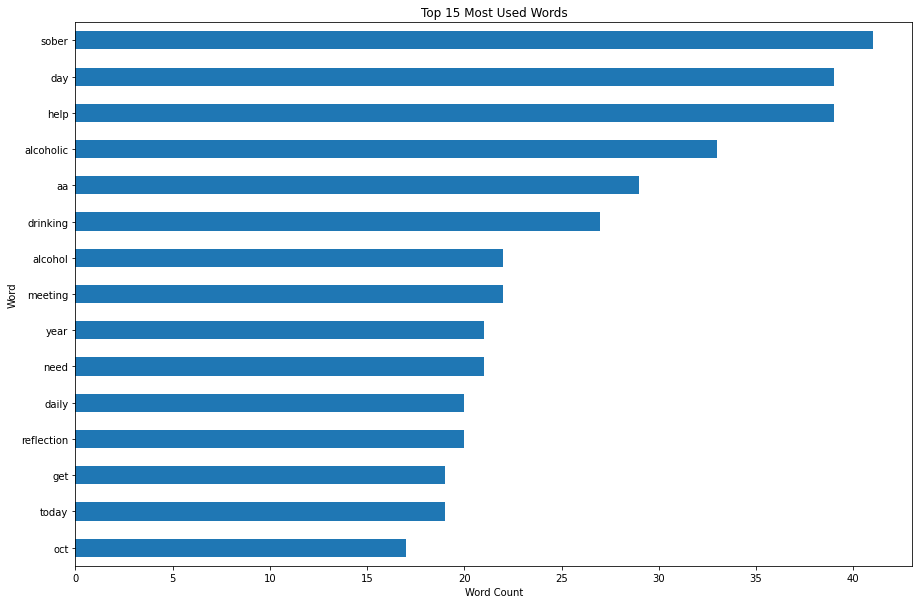

In [290]:
#create a horizontal Bar plot to visualize the top 15 words
plt.figure(figsize=(15,10))
filtered_messages_title_matrix.sum().sort_values(ascending=True).tail(15).plot(kind='barh')
plt.xlabel('Word Count')
plt.ylabel('Word')
plt.title('Top 15 Most Used Words')

As illustrated above, the some of the most common words used are words that may not have an impact to help identify in regards to Alcoholics Anonymous threads.  To take a better look, we can use the bigrams in N-Grams to see if the the neighboring word may better identify the differentiation to our problem statement.

# Vectorizing Title column: N-Grams

### For Title Column: Create function to remove punctuation, tokenize, remove stopwords, and lemmatize

In [291]:
def clean_text(title_text_ngram):
    title_text_ngram = "".join([word.lower() for word in title_text_ngram if word not in string.punctuation])
    title_tokens = re.split('\W+', title_text_ngram)
    # Requires a full sentence to be passed in as opposed to a tokenized list
    title_text_ngram = " ".join([wn.lemmatize(word) for word in title_tokens if word not in stopwords])
    return title_text_ngram

#create new column
filtered_messages_df['cleaned_token_title'] = filtered_messages_df['title'].apply(lambda x: clean_text(x))

#display sample of updated df
filtered_messages_df.head()

,author,title,selftext,subreddit,title_clean,title_clean_tokenized,title_clean_nostopwords,title_clean_lemmatized,cleaned_token_title
0,Brilliant-You2827,I sang sober!!,"I used to sing in a band. I also have sung a lot of karaoke. I have always been a singer. I am good at it. Once I got sober though, I just stopped. It's been almost 2 years since I have sang karaoke even. Partly because of Covid but mostly because I couldn't bring myself to go into a bar and sing sober. \nWell I finally went tonight. Me and my step dad went and drank Pepsi and I sang one song. I was terrified. Shaking before I even started. I mean almost a panic attack if I would have let my emotions take over. But I love to sing I was determined. I put up my song and had to wait for like 7 people to go before me. Every time he called the next singer my heart was beating so fast and I was short of breath. It was ridiculous. I mean, I have been singing my entire life. Why was a so damn scared. Finally they call my name and I get up there. My step dad said after the first two lines of the song he was a little worried. But after that, I fucking killed it. I killed it! I was amazing. I did it, and I did it fucking sober! I can still sing and I can still sing Rock and I can still get into it. Sober!! \nAfterwards I literally grabbed my purse and I walked out. I was shaking so bad I had to move. Everyone cheered and clapped and they wanted me to sing again but one was enough. I will probably go again soon with someone from the program that sings but damn. That first song sober. It was crazy. My nerves were insane and just one shot of vodka would have calmed me right down. But I don't need that anymore. Because of AA I know that if something terrifies me, I can do it anyway. I got a HP that is more powerful than what booze could ever give me. Thank you AA!",alcoholicsanonymous,I sang sober,"[i, sang, sober]","[sang, sober]","[sang, sober]",sang sober
1,adustyoldcrow462,Mildly concerned,I’ve cut down on drinking and doubled my dose of Wellbutrin (maintaining the same amount of Lamictal) and tonight I’m feeling overheated and inexplicably terrified. My heart is pounding. I’m a bit twitchy. I am so afraid of the prospect of a seizure. Please grant me reassurance,alcoholicsanonymous,Mildly concerned,"[mildly, concerned]","[mildly, concerned]","[mildly, concerned]",mildly concerned
2,MixFinancial9704,Surrendering to the winning side!,"In the meeting tonight this was the topic. It struck me because we fight so hard to hold on to the habits and lifestyles that completely demoralize are true authentic self . I was thinking back and wondering why so long did I hold on to the pain, was it pride or ego maybe it was the fact that I didn’t believe that life could get better. I had to do something and frankly even the bottle was getting old or should I say the same embarrassing messes I kept re-enacting hoping that one day my life would change. I person I once partied with was sober and suggested a meeting so I went. I walked into that room of 80+ alcoholics and was uncomfortable and not really taking it serious. I learned that day that I might have a slim chance of getting 1 month sober , it’s funny 1 month was my goal that was back in June 1 2018 3 + years later I was my home group and this was the topic . I did not know back then but I surrendered my old life for a brand new one and I don’t regret which team I have chosen. \n\nBest decision ever",alcoholicsanonymous,Surrendering to the winning side,"[surrendering, to, the, winning, side]","[surrendering, winning, side]","[surrendering, winning, side]",surrendering winning side
3,PsychologyLoose2787,I dont know what to do,[removed],alcoholicsanonymous,I dont know what to do,"[i, dont, know, what, to, do]","[dont, know]","[dont, know]",dont know
4,CAMPERzNITEMARE,Just Wanted to share my favourite song that got through the worst times in my life,https://m.youtube.com/watch?v=p4cJv6s_Yjw,alcoholicsanonymous,Just Wanted to share my 

### For Title: Apply CountVectorizer (w/ N-Grams)

In [292]:
from sklearn.feature_extraction.text import CountVectorizer

# ngram_range refers to the range of n-grams that we would like to look for.
title_ngram_vect = CountVectorizer(ngram_range=(2,2))
title_X_counts_ngram = title_ngram_vect.fit_transform(filtered_messages_df['cleaned_token_title'])

# Data Set has 5086 unique 2-word combinations
print(title_X_counts_ngram.shape)

print('\n')

#print out a list of the words
print(title_ngram_vect.get_feature_names())

(1997, 5001)


['091719 68', '10 apply', '10 day', '10 grew', '10 ish', '10 second', '10 year', '100 day', '100 hour', '101 day', '1013 shot', '102 day', '103 day', '104 day', '10593 day', '106 day', '108 day', '109 day', '11 day', '11 month', '11 year', '110 day', '111 day', '112 day', '113 day', '12 amp', '12 bottle', '12 day', '12 spiritual', '12 step', '12 week', '12 year', '120 day', '125 12amp12', '12784 day', '12stepper housemate', '12th step', '13 day', '13 month', '13 stepping', '13th step', '13th stepped', '14 day', '14 month', '14 year', '1415 year', '15 year', '16 month', '16 struggling', '16 year', '17 going', '17 im', '17 struggle', '17 year', '17m drink', '18 college', '18 day', '18 depressed', '18 month', '18 stop', '18 year', '183 six', '18f got', '18th birthday', '19 21', '19 think', '19 year', '19f like', '1st 430pm', '1st day', '1st drunk', '1st full', '1st meeting', '20 day', '20 really', '20 think', '20 year', '2021 day', '20f write', '21 day', '21 sober', '21 yea

### For Title: Apply CountVectorizer (w/ N-Grams) to smaller sample

In [293]:
#filter out top 1500 rows of titles
title_filtered_messages_sample = filtered_messages_df[0:1500]

#instantiate the CountVectorizer object
#transforms the body text into features
#create columns with word counts for each comment
title_ngram_vect_sample = CountVectorizer(ngram_range=(2,2), max_features=100)

#do a fit transform to the vectorizer
title_X_counts_sample_ngram = title_ngram_vect_sample.fit_transform(title_filtered_messages_sample['cleaned_token_title'])

#print out results
print(title_X_counts_sample_ngram.shape)
print("\n")
print(title_ngram_vect_sample.get_feature_names())

(1500, 100)


['12 step', '20 day', '24 hour', '30 day', '4th step', '5th step', '90 day', 'aa meeting', 'aa work', 'alcohol free', 'alcoholic anonymous', 'alcoholic dont', 'alcoholic father', 'anyone else', 'big book', 'binge drinking', 'clean sober', 'daily reflection', 'day ago', 'day later', 'day one', 'day sober', 'day three', 'day today', 'day two', 'dont know', 'dont miss', 'dont want', 'drink much', 'drinking much', 'drinking problem', 'early recovery', 'every night', 'fact alcohol', 'feel like', 'feeling like', 'find sponsor', 'first meeting', 'first time', 'friend aa', 'get better', 'get sober', 'help need', 'help please', 'hi im', 'hi name', 'higher power', 'im 20', 'im alcoholic', 'know problem', 'last drink', 'last night', 'last year', 'looking advice', 'looking help', 'making amends', 'meeting today', 'mental health', 'might alcoholic', 'month sober', 'need advice', 'need help', 'new aa', 'one day', 'one month', 'one year', 'online aa', 'online meeting', 'please help', 'p

In [294]:
#create a NumPy array from x counts sample
#create a new dataframe 'x_counts_df'
title_X_counts_df = pd.DataFrame(title_X_counts_sample_ngram.toarray())

#create column names from the feature names
title_X_counts_df.columns = title_ngram_vect_sample.get_feature_names()

#display output df
title_X_counts_df

,12 step,20 day,24 hour,30 day,4th step,5th step,90 day,aa meeting,aa work,alcohol free,alcoholic anonymous,alcoholic dont,alcoholic father,anyone else,big book,binge drinking,clean sober,daily reflection,day ago,day later,day one,day sober,day three,day today,day two,dont know,dont miss,dont want,drink much,drinking much,drinking problem,early recovery,every night,fact alcohol,feel like,feeling like,find sponsor,first meeting,first time,friend aa,get better,get sober,help need,help please,hi im,hi name,higher power,im 20,im alcoholic,know problem,last drink,last night,last year,looking advice,looking help,making amends,meeting today,mental health,might alcoholic,month sober,need advice,need help,new aa,one day,one month,one year,online aa,online meeting,please help,problem alcohol,quit drinking,reflection nov,reflection oct,reflection sep,right place,rock bottom,serenity prayer,serious question,sober today,sobriety vlog,speaker meeting,stay sober,stop drinking,strength hope,think im,think might,time admitting,today day,two day,two year,want drink,want quit,week sober,went first,without drink,year old,year sober,year sobriety,year today,zoom meeting
0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
5,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
6,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
7,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
8,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
9,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [295]:
#Save as backup
title_X_counts_df.to_csv("../data/BACKUP/AA_Title_X_Counts_DF.csv")

___
___
# For Selftext: Lemmatize the Text
___

###  Create function to remove punctuation, tokenize, remove stopwords, and lemmatize for Selftext

In [296]:
def clean_text(text_of_selftext):
    text_of_selftext = "".join([word.lower() for word in text_of_selftext if word not in string.punctuation])
    # \W matches any non-word character (equivalent to [^a-zA-Z0-9_]). This does not include spaces i.e. \s
    # Add a + just in case there are 2 or more spaces between certain words
    selftext_tokens = re.split('\W+', text_of_selftext)
    
    # apply stemming and stopwords exclusion within the same step
    text_of_selftext = [wn.lemmatize(word) for word in selftext_tokens if word not in stopwords]
    return text_of_selftext

### Apply CountVectorizer for Selftext

In [297]:
# Create an instance of CountVectorizer and pass in the clean_text function as the analyzer parameter
selftext_count_vect = CountVectorizer(analyzer=clean_text)

# selftext_X_counts stores the vectorized version of the data
selftext_X_counts = selftext_count_vect.fit_transform(filtered_messages_df['selftext'])

# Returns the number of rows and columns of selftext_X_counts
print(selftext_X_counts.shape)

#create spacing
print('\n')

# Returns the unique words across all text messages
print(selftext_count_vect.get_feature_names())

(1997, 10427)


['', '0', '027', '028038', '0330', '04', '042', '0430', '05', '060', '09', '1', '10', '100', '1000', '10000', '100000', '1000mph', '100hr', '100lbs', '101', '1010', '1011', '1012mg', '1015', '102', '103', '105', '106', '107', '108', '109', '10am', '10days', '10pm', '10th', '11', '110', '1100pm', '111', '1120', '113', '1130', '116', '11am', '11b', '12', '120', '120lbs', '120oz', '1212', '1213', '1214', '1215', '1224', '123', '1236', '124', '125', '12829', '12am', '12amp12the', '12th', '12x12', '12years', '13', '130', '130lb', '131', '1314', '1317', '132', '134', '139', '13940', '13months', '13th', '14', '1416', '1421', '148', '14months', '14th', '15', '150', '1500', '150bpm', '151', '152', '1521', '156', '15898517', '159', '15l', '15th', '15yrs', '16', '160110', '1618', '1619', '1624', '164', '166', '167', '16am', '16oz', '17', '171', '175', '175l', '175ml', '176', '176cm', '177', '17th', '18', '180', '180lbs', '1819', '1819years', '1820mg', '1828', '183', '184', '187', 

## Apply CountVectorizer to smaller sample sized Selftext

In [298]:
#create a sample size to reduce the number to work with
selftext_data_sample = filtered_messages_df[0:1500]

# Create an instance of CountVectorizer and pass in the clean_text function as the analyzer parameter
selftext_count_vect_sample = CountVectorizer(analyzer=clean_text, max_features=100)

# selftext_X_counts stores the vectorized version of the data
selftext_X_counts_sample = selftext_count_vect_sample.fit_transform(selftext_data_sample['selftext'])

# Returns the number of rows and columns of selftext_X_counts
print(selftext_X_counts_sample.shape)

#create spacing
print("\n")

# Returns the unique words across all text messages
print(selftext_count_vect_sample.get_feature_names())


(1500, 100)


['2', '3', 'aa', 'ago', 'alcohol', 'alcoholic', 'also', 'always', 'anyone', 'around', 'back', 'bad', 'better', 'cant', 'come', 'could', 'day', 'dont', 'drank', 'drink', 'drinking', 'drunk', 'even', 'every', 'everyone', 'family', 'feel', 'feeling', 'felt', 'find', 'first', 'friend', 'get', 'getting', 'go', 'god', 'going', 'good', 'got', 'hard', 'help', 'home', 'im', 'ive', 'keep', 'know', 'last', 'life', 'like', 'long', 'lot', 'love', 'made', 'make', 'meeting', 'month', 'much', 'need', 'never', 'new', 'night', 'one', 'people', 'person', 'point', 'problem', 'program', 'really', 'right', 'said', 'say', 'see', 'since', 'sober', 'sobriety', 'someone', 'something', 'sponsor', 'started', 'step', 'still', 'stop', 'take', 'thing', 'think', 'thought', 'time', 'today', 'told', 'trying', 'two', 'want', 'way', 'week', 'well', 'went', 'without', 'work', 'would', 'year']


## Vectorizers output sparse matrices for sampled sized Selftext

In [299]:
#how the rows and column
selftext_X_counts_sample

<1500x100 sparse matrix of type '<class 'numpy.int64'>'
	with 24263 stored elements in Compressed Sparse Row format>

In [300]:
# Due to the nature of sparse matrices where only non-zero elements are stored, 
# we would need to expand it out to a collection of arrays and then store it in a data frame
selftext_X_counts_df_sample = pd.DataFrame(selftext_X_counts_sample.toarray())
selftext_X_counts_df_sample.head()

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99
0,1,0,2,0,0,0,1,1,0,0,0,1,0,0,0,1,0,1,1,0,0,0,2,1,1,0,0,0,0,0,2,0,2,0,3,0,0,1,2,0,0,0,0,0,0,1,0,1,1,0,1,1,0,0,0,0,0,1,0,0,0,3,1,0,0,0,1,0,1,1,0,0,1,5,0,1,1,0,1,2,3,0,1,0,0,0,1,0,0,0,1,0,0,0,1,2,0,0,2,1
1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,0,1,0,0,0,1,0,0,0,0,3,0,1,0,0,1,2,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,2,0,0,0,0,0,1,0,1,0,0,0,1,0,3,0,1,0,0,0,0,2,2,0,0,0,1,0,2,0,1,0,0,0,1,0,0,1,0,0,2,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,1
3,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [301]:
#save file ask backup
selftext_X_counts_df_sample.to_csv('../data/BACKUP/AA_Selftext_X_Counts_of_Sample.csv')

In [302]:
selftext_X_counts_df_sample.columns = selftext_count_vect_sample.get_feature_names()
selftext_X_counts_df_sample.head()

,2,3,aa,ago,alcohol,alcoholic,also,always,anyone,around,back,bad,better,cant,come,could,day,dont,drank,drink,drinking,drunk,even,every,everyone,family,feel,feeling,felt,find,first,friend,get,getting,go,god,going,good,got,hard,help,home,im,ive,keep,know,last,life,like,long,lot,love,made,make,meeting,month,much,need,never,new,night,one,people,person,point,problem,program,really,right,said,say,see,since,sober,sobriety,someone,something,sponsor,started,step,still,stop,take,thing,think,thought,time,today,told,trying,two,want,way,week,well,went,without,work,would,year
0,1,0,2,0,0,0,1,1,0,0,0,1,0,0,0,1,0,1,1,0,0,0,2,1,1,0,0,0,0,0,2,0,2,0,3,0,0,1,2,0,0,0,0,0,0,1,0,1,1,0,1,1,0,0,0,0,0,1,0,0,0,3,1,0,0,0,1,0,1,1,0,0,1,5,0,1,1,0,1,2,3,0,1,0,0,0,1,0,0,0,1,0,0,0,1,2,0,0,2,1
1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,0,1,0,0,0,1,0,0,0,0,3,0,1,0,0,1,2,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,2,0,0,0,0,0,1,0,1,0,0,0,1,0,3,0,1,0,0,0,0,2,2,0,0,0,1,0,2,0,1,0,0,0,1,0,0,1,0,0,2,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,1
3,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


### EDA: See what are the top 50 words used under Selftext Column
___

In [303]:
#create a feature name dataframe for title column
filtered_messages_selftext_matrix = pd.DataFrame(selftext_X_counts_df_sample, columns=selftext_count_vect_sample.get_feature_names())

#showcase the top 50 words used in the title column 
filtered_messages_selftext_matrix.sum().sort_values(ascending=False).head(50)

day          1010
like          999
im            944
drinking      931
know          915
time          890
drink         842
feel          828
year          775
get           760
sober         702
want          643
meeting       615
aa            612
life          611
one           559
really        549
would         546
go            536
alcohol       510
going         503
thing         487
people        481
alcoholic     456
work          448
month         440
help          439
ive           428
got           421
dont          410
back          406
think         397
step          395
much          385
even          378
week          378
never         367
make          352
need          348
still         344
first         327
way           327
friend        324
last          319
night         310
drunk         300
every         300
say           291
anyone        288
stop          285
dtype: int64

Text(0.5, 1.0, 'Top 15 Most Used Words')

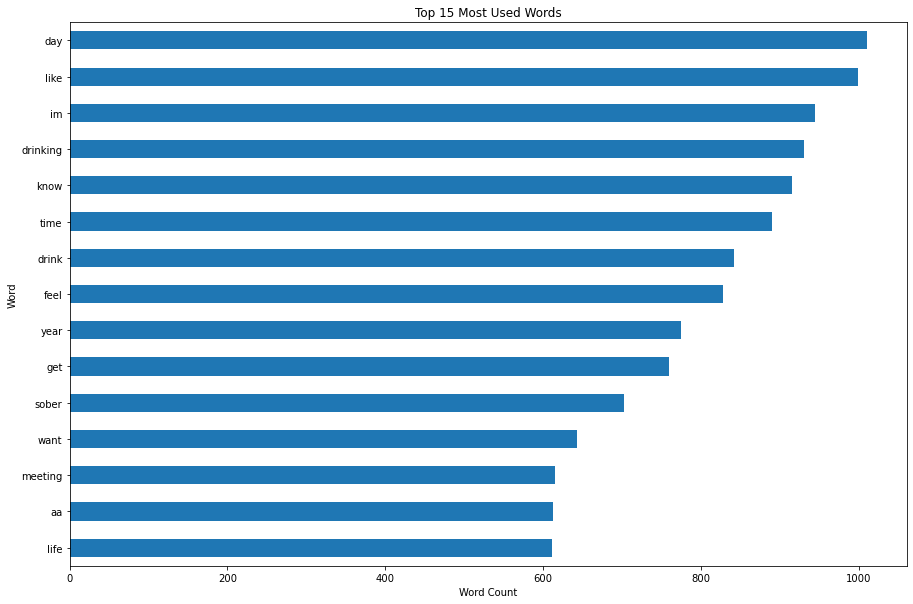

In [304]:
#create a horizontal Bar plot to visualize the top 15 words
plt.figure(figsize=(15,10))
filtered_messages_selftext_matrix.sum().sort_values(ascending=True).tail(15).plot(kind='barh')
plt.xlabel('Word Count')
plt.ylabel('Word')
plt.title('Top 15 Most Used Words')

## N-Grams for Selftext: Create function to remove punctuation, tokenize, remove stopwords, and lemmatize

In [305]:
def clean_text(text_of_selftext):
    text_of_selftext = "".join([word.lower() for word in text_of_selftext if word not in string.punctuation])
    self_tokens = re.split('\W+', text_of_selftext)
    # Requires a full sentence to be passed in as opposed to a tokenized list
    text_of_selftext = " ".join([wn.lemmatize(word) for word in self_tokens if word not in stopwords])
    return text_of_selftext

filtered_messages_df['cleaned_token_selftext'] = filtered_messages_df['selftext'].apply(lambda x: clean_text(x))
filtered_messages_df.head()

,author,title,selftext,subreddit,title_clean,title_clean_tokenized,title_clean_nostopwords,title_clean_lemmatized,cleaned_token_title,cleaned_token_selftext
0,Brilliant-You2827,I sang sober!!,"I used to sing in a band. I also have sung a lot of karaoke. I have always been a singer. I am good at it. Once I got sober though, I just stopped. It's been almost 2 years since I have sang karaoke even. Partly because of Covid but mostly because I couldn't bring myself to go into a bar and sing sober. \nWell I finally went tonight. Me and my step dad went and drank Pepsi and I sang one song. I was terrified. Shaking before I even started. I mean almost a panic attack if I would have let my emotions take over. But I love to sing I was determined. I put up my song and had to wait for like 7 people to go before me. Every time he called the next singer my heart was beating so fast and I was short of breath. It was ridiculous. I mean, I have been singing my entire life. Why was a so damn scared. Finally they call my name and I get up there. My step dad said after the first two lines of the song he was a little worried. But after that, I fucking killed it. I killed it! I was amazing. I did it, and I did it fucking sober! I can still sing and I can still sing Rock and I can still get into it. Sober!! \nAfterwards I literally grabbed my purse and I walked out. I was shaking so bad I had to move. Everyone cheered and clapped and they wanted me to sing again but one was enough. I will probably go again soon with someone from the program that sings but damn. That first song sober. It was crazy. My nerves were insane and just one shot of vodka would have calmed me right down. But I don't need that anymore. Because of AA I know that if something terrifies me, I can do it anyway. I got a HP that is more powerful than what booze could ever give me. Thank you AA!",alcoholicsanonymous,I sang sober,"[i, sang, sober]","[sang, sober]","[sang, sober]",sang sober,used sing band also sung lot karaoke always singer good got sober though stopped almost 2 year since sang karaoke even partly covid mostly couldnt bring go bar sing sober well finally went tonight step dad went drank pepsi sang one song terrified shaking even started mean almost panic attack would let emotion take love sing determined put song wait like 7 people go every time called next singer heart beating fast short breath ridiculous mean singing entire life damn scared finally call name get step dad said first two line song little worried fucking killed killed amazing fucking sober still sing still sing rock still get sober afterwards literally grabbed purse walked shaking bad move everyone cheered clapped wanted sing one enough probably go soon someone program sings damn first song sober crazy nerve insane one shot vodka would calmed right dont need anymore aa know something terrifies anyway got hp powerful booze could ever give thank aa
1,adustyoldcrow462,Mildly concerned,I’ve cut down on drinking and doubled my dose of Wellbutrin (maintaining the same amount of Lamictal) and tonight I’m feeling overheated and inexplicably terrified. My heart is pounding. I’m a bit twitchy. I am so afraid of the prospect of a seizure. Please grant me reassurance,alcoholicsanonymous,Mildly concerned,"[mildly, concerned]","[mildly, concerned]","[mildly, concerned]",mildly concerned,cut drinking doubled dose wellbutrin maintaining amount lamictal tonight feeling overheated inexplicably terrified heart pounding bit twitchy afraid prospect seizure please grant reassurance
2,MixFinancial9704,Surrendering to the winning side!,"In the meeting tonight this was the topic. It struck me because we fight so hard to hold on to the habits and lifestyles that completely demoralize are true authentic self . I was thinking back and wondering why so long did I hold on to the pain, was it pride or ego maybe it was the fact that I didn’t believe that life could get better. I had to do something and frankly even the bottle was get

## N-Gram for Selftext: Apply CountVectorizer

In [306]:
from sklearn.feature_extraction.text import CountVectorizer

# ngram_range refers to the range of n-grams that we would like to look for. 
selftext_ngram_vect = CountVectorizer(ngram_range=(2,2))
selftext_X_counts = selftext_ngram_vect.fit_transform(filtered_messages_df['cleaned_token_selftext'])

# Data Set has 94781 unique 2-word combinations
print(selftext_X_counts.shape)

print(selftext_ngram_vect.get_feature_names())

(1997, 94961)
['027 alcohol', '028038 percent', '0330 wake', '04 typo', '042 im', '0430 noon', '05 beer', '05 care', '060 real', '09 dh', '10 11', '10 12', '10 2020', '10 alcohol', '10 apparent', '10 basically', '10 beer', '10 day', '10 different', '10 drink', '10 end', '10 got', '10 hour', '10 inconstancy', '10 min', '10 minute', '10 month', '10 never', '10 people', '10 plus', '10 pound', '10 selfdiscipline', '10 shot', '10 sponsees', '10 spread', '10 tallboy', '10 time', '10 triple', '10 white', '10 year', '10 zoom', '100 100', '100 aa', '100 accepting', '100 addiction', '100 alcohol', '100 alone', '100 although', '100 always', '100 aware', '100 big', '100 certainty', '100 clean', '100 committed', '100 consecutive', '100 day', '100 drank', '100 drinking', '100 employee', '100 enough', '100 full', '100 honest', '100 hour', '100 mph', '100 percent', '100 pure', '100 sober', '100 sobriety', '100 standard', '100 success', '100 sure', '100 time', '100 topic', '100 true', '100 wanting', '1

## N-Gram for Selftext: Apply CountVectorizer to smaller sample

In [307]:
#filter out top 1500 rows of titles
filtered_messages_sample = filtered_messages_df[0:1500]

#instantiate the CountVectorizer object
#transforms the body text into features
#create columns with word counts for each comment
self_ngram_vect_sample = CountVectorizer(ngram_range=(2,2), max_features=100)

#do a fit transform to the vectorizer
selftext_X_counts_sample = self_ngram_vect_sample.fit_transform(filtered_messages_sample['cleaned_token_selftext'])

#print out results
print(selftext_X_counts_sample.shape)
print("\n")
print(self_ngram_vect_sample.get_feature_names())

(1500, 100)


['10 year', '12 step', '20 year', '24 hour', 'aa meeting', 'aa online', 'aa service', 'alcoholic anonymous', 'alcoholic anonymoushttpsaaintergrouporg', 'anonymoushttpsaaintergrouporg aa', 'anyone else', 'available meetinghttpsaaintergrouporgoiaameetings', 'best friend', 'big book', 'browse aa', 'cold turkey', 'day ago', 'day sober', 'day sobriety', 'day time', 'day week', 'dont know', 'dont really', 'dont want', 'drink every', 'drink much', 'drinking every', 'even though', 'every day', 'every night', 'every time', 'feel bad', 'feel better', 'feel good', 'feel like', 'feeling like', 'felt like', 'find next', 'first time', 'get back', 'get better', 'get drunk', 'get help', 'get sober', 'go back', 'go meeting', 'going back', 'going meeting', 'got drunk', 'got sober', 'higher power', 'home group', 'im alcoholic', 'im going', 'im sure', 'intergroup alcoholic', 'know im', 'last night', 'last time', 'last week', 'last year', 'let know', 'like im', 'long time', 'make feel', 'many

## Vectorizers output sparse matrices

In [308]:
selftext_X_counts_sample

<1500x100 sparse matrix of type '<class 'numpy.int64'>'
	with 3541 stored elements in Compressed Sparse Row format>

In [309]:
# Due to the nature of sparse matrices where only non-zero elements are stored, 
# we would need to expand it out to a collection of arrays and then store it in a data frame
selftext_X_counts_df_sample = pd.DataFrame(selftext_X_counts_sample.toarray())
selftext_X_counts_df_sample

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99
0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
5,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
6,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
7,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
8,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
9,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [310]:
#save the file as a backup
selftext_X_counts_df_sample.to_csv('../data/BACKUP/AA_NGrams_Selftext_X_Counts_of_Sample.csv')

In [311]:
#create a NumPy array from x counts sample
#create a new dataframe 'x_counts_df'
selftext_sample_X_counts_df = pd.DataFrame(selftext_X_counts_sample.toarray())

#create column names from the feature names
selftext_sample_X_counts_df.columns = self_ngram_vect_sample.get_feature_names()

#display output df
selftext_sample_X_counts_df

,10 year,12 step,20 year,24 hour,aa meeting,aa online,aa service,alcoholic anonymous,alcoholic anonymoushttpsaaintergrouporg,anonymoushttpsaaintergrouporg aa,anyone else,available meetinghttpsaaintergrouporgoiaameetings,best friend,big book,browse aa,cold turkey,day ago,day sober,day sobriety,day time,day week,dont know,dont really,dont want,drink every,drink much,drinking every,even though,every day,every night,every time,feel bad,feel better,feel good,feel like,feeling like,felt like,find next,first time,get back,get better,get drunk,get help,get sober,go back,go meeting,going back,going meeting,got drunk,got sober,higher power,home group,im alcoholic,im going,im sure,intergroup alcoholic,know im,last night,last time,last week,last year,let know,like im,long time,make feel,many time,mental health,month ago,month sober,need help,next available,next day,one day,online intergroup,online resourceshttpsaaintergrouporgoiaaresources,past year,really want,resourceshttpsaaintergrouporgoiaaresources aa,seems like,service youtubehttpstinyurlcomaag2kplaylist,someone else,started drinking,stay sober,step twelve,stop drinking,trying get,twelve step,twelve tradition,two year,want drink,want go,want stop,week ago,working step,would like,year ago,year old,year sober,year sobriety,youtubehttpstinyurlcomaag2kplaylist find
0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
5,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
6,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
7,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
8,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
9,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


## EDA: Find out what are the top words used for N-Grams Selftext Column

In [312]:
#create a feature name dataframe for selftext column
filtered_messages_selftext_matrix = pd.DataFrame(selftext_sample_X_counts_df, columns=self_ngram_vect_sample.get_feature_names())

#showcase the top 50 words used in the selftext column 
filtered_messages_selftext_matrix.sum().sort_values(ascending=False).head(50)

feel like                                            303
dont know                                             90
every day                                             82
aa meeting                                            78
aa service                                            77
year old                                              76
year ago                                              76
stop drinking                                         76
dont want                                             71
first time                                            62
last night                                            61
day sober                                             59
service youtubehttpstinyurlcomaag2kplaylist           58
im going                                              57
last year                                             54
higher power                                          54
one day                                               53
month ago                      

Text(0.5, 1.0, 'Top 15 Most Used Paired Words')

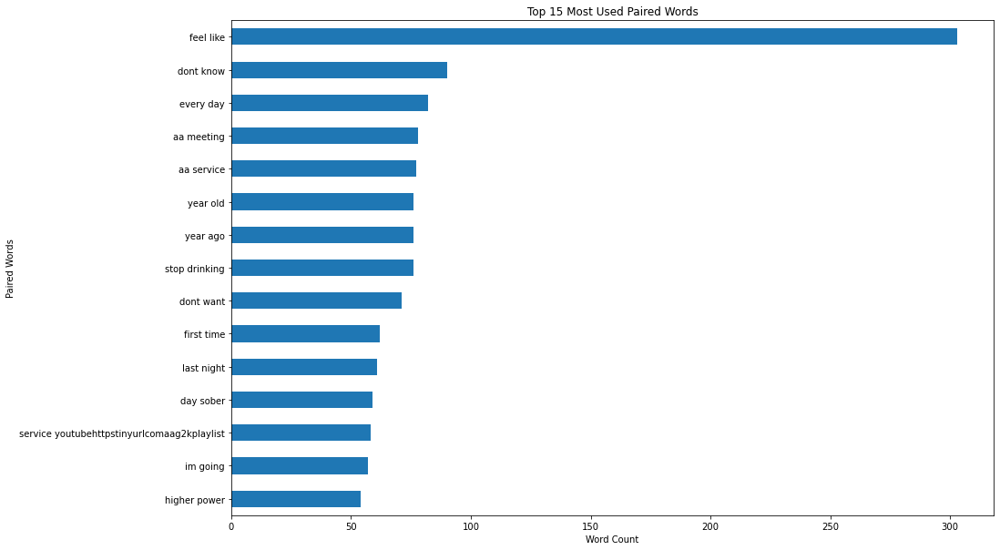

In [313]:
#create a horizontal Bar plot to visualize the top 15 paired words
plt.figure(figsize=(15,10))
filtered_messages_selftext_matrix.sum().sort_values(ascending=True).tail(15).plot(kind='barh')
plt.xlabel('Word Count')
plt.ylabel('Paired Words')
plt.title('Top 15 Most Used Paired Words')

In [314]:
#add subreddit column to the selftext_sample_X_counts_df to complete the data set
selftext_sample_X_counts_df['subreddit'] = filtered_messages['subreddit']

In [315]:
#check sample to make sure the subreddit column is added
selftext_sample_X_counts_df.head()

,10 year,12 step,20 year,24 hour,aa meeting,aa online,aa service,alcoholic anonymous,alcoholic anonymoushttpsaaintergrouporg,anonymoushttpsaaintergrouporg aa,anyone else,available meetinghttpsaaintergrouporgoiaameetings,best friend,big book,browse aa,cold turkey,day ago,day sober,day sobriety,day time,day week,dont know,dont really,dont want,drink every,drink much,drinking every,even though,every day,every night,every time,feel bad,feel better,feel good,feel like,feeling like,felt like,find next,first time,get back,get better,get drunk,get help,get sober,go back,go meeting,going back,going meeting,got drunk,got sober,higher power,home group,im alcoholic,im going,im sure,intergroup alcoholic,know im,last night,last time,last week,last year,let know,like im,long time,make feel,many time,mental health,month ago,month sober,need help,next available,next day,one day,online intergroup,online resourceshttpsaaintergrouporgoiaaresources,past year,really want,resourceshttpsaaintergrouporgoiaaresources aa,seems like,service youtubehttpstinyurlcomaag2kplaylist,someone else,started drinking,stay sober,step twelve,stop drinking,trying get,twelve step,twelve tradition,two year,want drink,want go,want stop,week ago,working step,would like,year ago,year old,year sober,year sobriety,youtubehttpstinyurlcomaag2kplaylist find,subreddit
0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,alcoholicsanonymous
1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,alcoholicsanonymous
2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,alcoholicsanonymous
3,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,alcoholicsanonymous
4,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,alcoholicsanonymous


To get the best result for the study, we have decided to filter down the previous cleaned dataframes to just 'selftext' and 'subreddit' columns.  This is because the 'selftext' column contains the "meat" of each author's post which gives the computer more information to study on.  The 'subreddit' column will train the system to understand where the 'selftext' belongs to so it can associate some of the words to the proper subreddit.

In [316]:
#this will be used for Naive Bayes later
selftext_sample_X_counts_df.to_csv("../data/BACKUP/AA_NGrams_Selftext_X_Count_DF.csv")

## Create a Wordcloud to visually see what are the top 100 words used most commonly in Alocoholics Anonymous
___

In [317]:
from PIL import Image
import numpy as np
from wordcloud import WordCloud, STOPWORDS, ImageColorGenerator

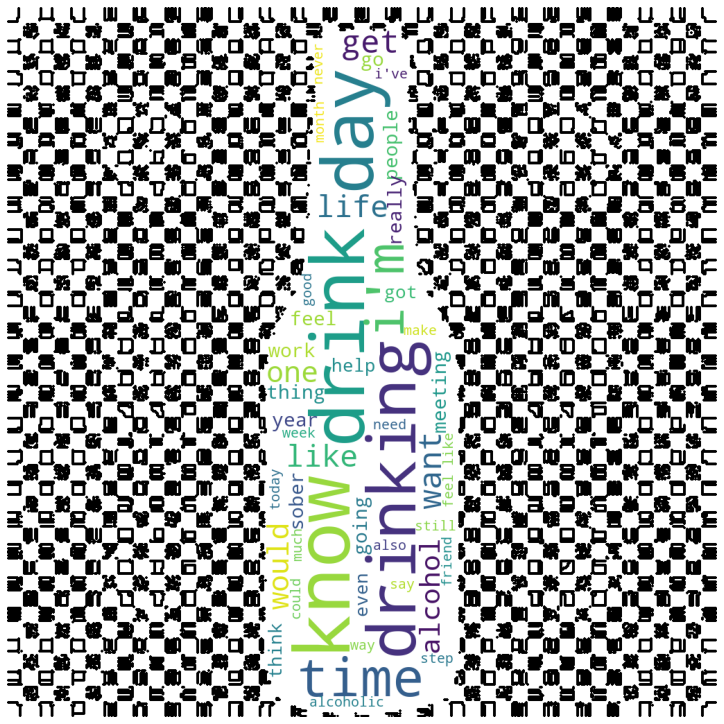

In [318]:
#Before preprocessing the dataset i.e. Remove punctuations, Tokenization, Remove stopwords,Lemmatize,
#Let's visualize the top 100 words in each subreddit (alcoholics_final, smoking_final)

#Visualize top 100 words in alcoholics anonymous
text = ''
stopwords = nltk.corpus.stopwords.words('english')
 
# iterate through train
for val in filtered_messages_df.selftext:
     
    # typecaste each val to string
    val = str(val)
 
    # split the value
    tokens = val.split()
     
    # Converts each token into lowercase
    for i in range(len(tokens)):
        tokens[i] = tokens[i].lower()      
     
    text += " ".join(tokens)+" "
    
mask = np.array(Image.open("../img/bottle.jpg"))

wordcloud = WordCloud(max_words= 100,
                      width = 800, height = 800,
                      mask=mask,
                      background_color ='white',
                      stopwords = stopwords,
                      scale=2,
                      margin=2,
                      contour_width=3,
                      contour_color='black',
                      min_font_size = 10).generate(text)
 
# plot the WordCloud image                      
plt.figure(figsize = (10, 10), facecolor = None)
plt.imshow(wordcloud)
plt.axis("off")
plt.tight_layout(pad = .5)
 
plt.show()